# Re-integration of icm single-nuclei data

In [1]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

%cd /nfs/team205/vk8/processed_data/muscle/data_v3
import scrublet as scr
from doublet_detection import *

#myonuclei_res_folder = '/nfs/team205/vk8/scripts/scvi/Results/SKM_myonuclei/'

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pytorch_lightning/metrics/__init__.py:44: LightningDeprecationWarning: `pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package (https://github.com/PyTorchLightning/metrics) since v1.3 and will be removed in v1.5
  "`pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package"
Global seed set to 0


/nfs/team205/vk8/processed_data/muscle/data_v3


In [2]:
general_mrkrs = [ 'MYH7', 'TNNT1', 'TNNT3', 'MYH1', 'MYH2', "CKM", "MB", # Myofibers
           'PAX7', 'DLK1', # MuSCs
           'PDGFRA', 'DCN', 'ANGPTL7', 'OSR2', 'NGFR', 'SLC22A3','ITGA6', # Fibroblasts
           'FMOD', 'TNMD' ,  'MKX', # Tenocytes
 'MPZ', 'MBP',  # Schwann cells
'CDH2', 'L1CAM', # SCG
'MSLN', 'ITLN1', # mesothelium
"ADIPOQ", "PLIN1", # adipocytes
'PTPRC', 'CD3D', 'IL7R', # T cells
'NKG7', 'PRF1', #NK cells
'CD79A', "TCL1A",  # B cells
'MZB1', 'JCHAIN', # B plasma 
"CD14", "FCGR3A",'S100A8', 'S100A12', # Mono
"CD163", "C1QA", # Macrop
"XCR1", "CLEC9A", # cDC1 "CADM1",
"CD1C", "CLEC10A", "CCR7", # cDC2
'LILRA4', 'IL3RA', "IRF7",  # pDC 
'FCGR3B', 'CSF3R', 'SORL1',  # Neutrophils
'EPX', 'PRG2', # Eosinophils 'CLC'
'TPSB2', 'MS4A2', # Mast cells
'PECAM1', 'HEY1','CLU', # art EC
'CA4', 'LPL', # capEC
'ACKR1', 'SELE', # venEC
'LYVE1', 'TFF3',  # lymphEC
'RGS5','ABCC9', # pericytes           
'MYH11', 'ACTA2', # SMC
'HBA1', #RBC
'SORBS2', 'EFNA5', 'GRIA2', # SORBS2 population
'MUSK', 'ACHE',  #NMJ
'MAML2', 'SNX7', # MTJ
 'FLCN', 'FNIP1', 'RASA4', # HOOK2
'CDKN1A','SAA1',  'MYH8', # MYH8 populations 
    ]
myofiber_mrkrs = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                 "CKM", "MB", "COX6C", # cytoplasmic populations
                'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3', # FAM189A2 population
                'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4', #'BDNF',  # 'NRAP', 'ANKRD1', 'XIRP2',  # OTUD1 population 
                    'TNFRSF12A',
                   'MUSK', 'ACHE', 'VMO1', 'PLCB4',  #NMJ
                    'NCAM1', 'MAML2', 'SNX7', # MTJ
                 'SORBS2', 'EFNA5', 'BMPR1B', 'GRIA2', 'STYK1', # SORBS2 population
                   'ACTC1', 'UCHL1', 'RGCC', 'MLLT11', # UCHL1 population
                    'MYOG', 'TNNT2', # TNNT2 population
                     'CDKN1A', 'ADIRF', 'SAA1',  'MYH8', # MYH8 populations 'MYOD1',
                   'FLCN', 'FNIP1', 'RASA4']

musc_mrkrs = ['PAX7', 'MYF5', 'SPRY1', 'TNFRSF12A', 'NOP16', 'NPTX2', 'FNDC4', 'MT1A', 'ICAM1', 'CXCL1', 'CXCL2', 
             'TNFAIP3', 'NFKBIZ', 'IRF1', 'IER3', 'MYOG', 'TNNI1', 'TNNT2', 'CKB', 'ACTC1', 'CLDN5', 'MYOD1']
vasculature_mrkrs = ['PECAM1', 'CLDN5', 'VWF', 'CLU', # pan-endothelial
                    'IGFBP3', 'HEY1', 'SEMA3G', 'MGP', 'GJA5', #arterial
                    'RGCC', 'FABP4', 'LGALS1', 'CD36', 'CA4', 'LPL', # capillary
                    'ACKR1', 'PLVAP', 'CCL14', 'ICAM1', 'SELE', 'RND1', 'RAMP3', # venous
                     'CCL2', 'GADD45B', 'SLC2A3', 'IRF1', 'ATF3', 'CDKN1A', # response
                    'CD8A', 'LYVE1', # lymphatic ec
                    'ACTA2', 'TAGLN', 'TPM2', 'MYH11', 'PLN', 'SORBS2', 'LBH', 'ATF3', 'IGFBP6', 'CNN1', 'RERGL', #
                    'CLU',  'RAMP1', # smc
                    'RGS5', 'APOD', 'ABCC9', 'STEAP4'] #pericyte
fibro_schwann_mrkrs = ['CD70', 'PTHLH', 'PI16', 'FBN1', 'DPP4', 'PRG4', 'PCOLCE2', # adventitial fibroblasts (close to blood vessels)
'COL4A1', 'COL15A1','ALDH1A2', 'HSPG2', # parenchymal fibroblasts (secretes extracellular matrix)
'COL3A1', 'COL1A1', 'COL5A2', 'THY1', 'SCG2', 'ACTA2', 'MYH11', 'CTHRC1', \
'ASPN', 'COL11A1', 'POSTN', 'ADAM12', 'COMP', 'NREP', 
'CKM', 'TNNT1', 'TNNT3',
'FMOD', 'TNMD', # tenocyte
'SLC22A3', 'KRT19', 'SORBS1', 'ITGA6', 'SLC2A1', 'FGL2', 'PDZRN4','NGFR', # perineural 
'CDH19', 'ANGPTL7', 'NGFR', # endoneural
'MLIP', 'MBP', 'MPZ', 'PLP1',  # myelinating Schwann cells
'CDH2', 'L1CAM', 'NRN1', 'SORBS2']

immune_mrkrs = ['CD79A', 'TCL1A', 'CD27', 'MKI67', 'TOP2A', 'JCHAIN', 'XBP1', # B cells
                              'CD160', 'XCL1', 'XCL2', 'IFNG', 'NCAM1', 'TYROBP', 'FCGR3A', 'PRF1', 'GZMB', 'GNLY', # NK cells
                              'CD3E', 'CD3G', 'SELL', 'CCR7', 'CD4', 'CD40LG', 'FOXP3', 'CTLA4', 'CD8A', 'CD8B', 'CRTAM', # T cells
                              'HLA-DRA', 'CD14', 'VCAN', 'S100A8', 'S100A12', 'FCGR3A', 'LILRA5','LILRB2',
                              'S100A6', 'S100A4','CD68', 'VCAN', 'FCN1','HLA-DRB1', 'LYVE1', 'F13A1', 'SELENOP', 
                              'APOE', 'APOC1', 'FABP5', 'SPP1', 'TREM2', 'LGALS2', 'CLEC9A', 'FCER1A', 'CLEC10A', 'CD1C', 'LILRA4', 'CLEC4C', #DC
                              'CD24', 'AZU1', 'MPO', 'ELANE', 'LTF', 'LCN2', 'CAMP', 'FCGR3B', 'CSF3R', 'LILRA5', 'EPX', 'CLC', 'PRG2', #granulocytes
                              'HDC', 'TPSAB1', 'TPSB2', 'MS4A2', 'HBA1', 'HBA2']
all_mrkrs = list(set(general_mrkrs+myofiber_mrkrs+musc_mrkrs+vasculature_mrkrs+fibro_schwann_mrkrs+immune_mrkrs))

## Import the data

In [3]:
metadata = pd.read_csv(f'ICM_muscle_ageing_meta_270223.csv')

In [1]:
adata_icm_prev = sc.read("cellxgene/raw/SKM_human_raw_cells2nuclei_2022-03-30.h5ad")
snuclei_samples = adata_icm_prev.obs.loc[adata_icm_prev.obs['batch'] == 'nuclei', 'SampleID'].unique().tolist()+\
['WS_A_SKM10691778', 'WS_A_SKM10691779', 'WS_A_SKM10691780', 'WS_A_SKM10691781', 'WS_A_SKM11147018', 'WS_A_SKM11147019']

NameError: name 'sc' is not defined

In [ ]:
len(snuclei_samples)

samples_added = ['WS_A_SKM10691778', 'WS_A_SKM10691779', 
'WS_A_SKM10490125', 'WS_A_SKM10490126', 'WS_A_SKM10490127', 'WS_A_SKM10490128', 'WS_A_SKM11147018',
'WS_A_SKM11147019']
adata_icm_prev = sc.read("cellxgene/raw/SKM_human_raw_cells2nuclei_2022-03-30.h5ad")
adata_icm_prev.obs.loc[adata_icm_prev.obs['SampleID'].isin(['5386STDY7796286', '5386STDY7796287', '5386STDY8090406', '5386STDY8090407',\
                                       'WS_A_SKM10691778', 'WS_A_SKM10691779', 'WS_A_SKM9845427', 'WS_A_SKM9845428', \
                                       'WS_A_SKM9426499', 'WS_A_SKM9426500']), 'SampleID'].value_counts()

samples_all = adata_icm_prev.obs['SampleID'].unique().tolist()
samples_cell = adata_icm_prev.obs.loc[adata_icm_prev.obs['batch'] == 'cells', 'SampleID'].unique().tolist()+metadata.loc[metadata['Sample']=='Single cells', 'SampleID'].tolist()[-4:]

len(samples_cell)

len(samples_all+samples_added)

pd.DataFrame(samples_all).to_csv("/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Sample_list_Feb27.txt", 
                                sep = "\t", header=False, index=False)
pd.DataFrame(samples_all+samples_added).to_csv("/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_cellbender_150epochs/Sample_list_Feb27.txt", 
                                sep = "\t", header=False, index=False)
pd.DataFrame(samples_cell).to_csv("/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_Gene_cellbender_150epochs/Sample_list_cells_Feb27.txt", 
                                sep = "\t", header=False, index=False)
pd.DataFrame(samples_all+samples_added)

In [ ]:
os.listdir("/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_GeneFull_cellbender_300epochs")

In [ ]:
def AnnData_from_files_v2_nuc(samples, starsolo_path, cellbender_path, meta, cellbender_path2 =''):
    #Writing output from separate samples, processed using CellRanger, into a dictionary of Scanpy objects:
    import numpy as np
    from scipy import sparse
    ad = []
    #Generate AnnData for each sample
    for sid in samples:
        cr_filt_path = f"{starsolo_path}/{sid}/GeneFull/raw/"
        cr_velo_path = f"{starsolo_path}/{sid}/Velocyto/velocyto.h5ad"
        if sid in os.listdir(cellbender_path2):
            cb_filt_path = f"{cellbender_path2}/{sid}/{sid}_filtered.h5"
        else:
            cb_filt_path = f"{cellbender_path}/{sid}/{sid}_filtered.h5"       
        cr_gene_filtered_ad = sc.read_10x_mtx(cr_filt_path)
        print("cr_gene_filtered_mtx read")
        cb_gene_filtered_ad = sc.read_10x_h5(cb_filt_path)
        print("cb_filtered_h5 read")
        
        velocyto_ad = sc.read_h5ad(cr_velo_path)
        print("velocyto has been read")
        common_cells = cb_gene_filtered_ad.obs_names.tolist()
        if (len(set(common_cells).difference(set(velocyto_ad.obs_names))))>0:
            print(f"Starsolo - Velocyto mismatch for {sid}")
        else:
            ad1 = sc.AnnData(
                X=cb_gene_filtered_ad[common_cells, :].X,
                obs=cb_gene_filtered_ad.obs.loc[common_cells,:].copy(),
                var=cb_gene_filtered_ad.var.copy(),
                layers={
                    "raw": cr_gene_filtered_ad[common_cells, :].X,
                    "spliced": velocyto_ad[common_cells, :].layers['spliced'],
                    "unspliced": velocyto_ad[common_cells, :].layers['unspliced'],
                    "ambiguous": velocyto_ad[common_cells, :].layers['ambiguous'],
                },
            )
            ad1.var.rename(columns = {'gene_ids':'ENSEMBL'}, inplace = True)
            ad1.var['SYMBOL'] = ad1.var.index
            ad1.var_names_make_unique() 
            ad1.obs['SampleID'] = sid
            ad1.obs['barcode'] = ad1.obs_names
            ad1.obs_names = ad1.obs['SampleID']+"-"+ad1.obs['barcode']
            ad.append(ad1)
            print(f"{sid} anndata created")
    from anndata import AnnData
    adata = ad[0].concatenate (ad[1:], batch_key = 'concat_sample_no', index_unique = None)
    #Add cleaned metadata to the Anndata.obs table
    obs_merged = pd.merge(left = adata.obs, right = meta, how = "left", left_on="SampleID", right_on="SampleID")
    obs_merged.index = obs_merged['SampleID']+"-"+obs_merged['barcode']
    adata.obs = obs_merged
    return adata

In [ ]:
len(snuclei_samples)

In [31]:
sample_ss = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/5386STDY8552613/GeneFull/raw'
sample_velo = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/5386STDY8552613/Velocyto/velocyto.h5ad'
sample_cb = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_GeneFull_cellbender_150epochs/5386STDY8552613/5386STDY8552613_filtered.h5'

adata_cb = sc.read_10x_h5(sample_cb)
adata_ss = sc.read_10x_mtx(sample_ss)
adata_velo = sc.read_h5ad(sample_velo)

adata_cb.shape
adata_ss.shape
adata_velo.shape

len(set(adata_cb.obs_names).difference(set(adata_velo.obs_names)))

len(set(adata_ss.obs_names).difference(set(adata_velo.obs_names)))

In [9]:
%%time
adata = AnnData_from_files_v2_nuc(samples = snuclei_samples, starsolo_path = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo', 
                            cellbender_path = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_GeneFull_cellbender_150epochs',
                            cellbender_path2 = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo_GeneFull_cellbender_300epochs',  
                            meta = metadata)

cr_gene_filtered_mtx read


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/scanpy/readwrite.py:243: FutureWarning: X.dtype being converted to np.float32 from uint32. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  gene_ids=dsets['genes'].astype(str),
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


cb_filtered_h5 read
velocyto has been read
mus_SNuc7468111 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY7600836 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY7600837 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY7645355 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY7796286 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY7796287 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY8090406 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY8090407 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY8493510 anndata created
cr_gene_filtered_mtx read
cb_filtered_h5 read
velocyto has been read
5386STDY8552613 anndata created
cr_gene_filtered

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


CPU times: user 15min 21s, sys: 1min 12s, total: 16min 33s
Wall time: 20min 16s


In [14]:
adata

AnnData object with n_obs × n_vars = 165277 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X version ', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells'
    layers: 'raw', 'spliced', 'unspliced', 'ambiguous'

### The more hv genes you use for the model to fit the better (al long as it fits in a reasonable time)

In [15]:
def AddMetadata (sample_object, velocyto, cellbender):
    sample_object.obs['n_counts'] = np.sum(sample_object.X, axis = 1).A1
    if cellbender:
        sample_object.obs['n_counts_raw'] = np.sum(sample_object.layers['raw'], axis = 1).A1
        sample_object.obs["percent_soup"] = (1 - (sample_object.obs["n_counts"] / sample_object.obs["n_counts_raw"]))* 100
    if velocyto:
        sample_object.obs['n_counts_spliced'] = np.sum(sample_object.layers['spliced'], axis = 1).A1
        sample_object.obs['n_counts_unspliced'] = np.sum(sample_object.layers['unspliced'], axis = 1).A1
        sample_object.obs["percent_spliced"] = (sample_object.obs["n_counts_spliced"]/
                                                (sample_object.obs["n_counts_spliced"] + sample_object.obs["n_counts_unspliced"]))* 100
    sample_object.obs['n_genes'] = np.sum(sample_object.X > 0, axis = 1).A1
    mito_genes = sample_object.var_names.str.startswith('MT-')
    ribo_genes = (sample_object.var_names.str.startswith('RPS')|sample_object.var_names.str.startswith('RPL'))
    hb_genes = sample_object.var_names.str.startswith('HB')
    sample_object.obs['percent_mito'] = np.sum(sample_object[:, mito_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.obs['percent_ribo'] = np.sum(sample_object[:, mito_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.obs['percent_hb'] = np.sum(sample_object[:, hb_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.var['n_counts'] = np.sum(sample_object.X, axis = 0).A1
    sample_object.var['n_cells'] = np.sum(sample_object.X>0, axis = 0).A1

In [16]:
AddMetadata (adata, velocyto = True, cellbender = True)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/ipykernel_launcher.py:17: RuntimeWarning: invalid value encountered in true_divide


In [19]:
adata.obs.rename(columns = {'10X version ': '10X_version'}, inplace = True)

In [22]:
adata.obs['Age_group'] = adata.obs['Age'].apply(lambda x: 'young' if x <=40 else 'old')

In [23]:
adata.write(f"updated_icm_snuclei/ICM_snuclei_data_integ_raw_{today}.h5ad")

## Do quick QC of the data

adata = sc.read("ICM_scell_data_integ_raw_2023-03-01.h5ad")
adata.obs.rename(columns = {'10X version ':'10X_version'}, inplace = True)
adata.obs['Age_group'] = adata.obs['Age'].apply(lambda x: 'young' if x <=40 else 'old')
adata.write(f"ICM_scell_data_integ_raw_{today}.h5ad")

In [3]:
adata = sc.read("updated_icm_snuclei/ICM_snuclei_data_integ_raw_2023-03-10.h5ad")

In [ ]:
['WS_A_SKM10691778', 'WS_A_SKM10691779', 'WS_A_SKM10691780', 'WS_A_SKM10691781', 'WS_A_SKM11147018', 'WS_A_SKM11147019'

In [4]:
adata.shape

(165277, 33538)

In [5]:
adata = adata[~adata.obs['SampleID'].isin(['WS_A_SKM10691780', 'WS_A_SKM10691781', 'WS_A_SKM11147018', 'WS_A_SKM11147019']),:].copy()

In [7]:
adata.write(f"updated_icm_snuclei/ICM_snuclei_data_raw_fin_{today}.h5ad")

In [8]:
del adata.layers

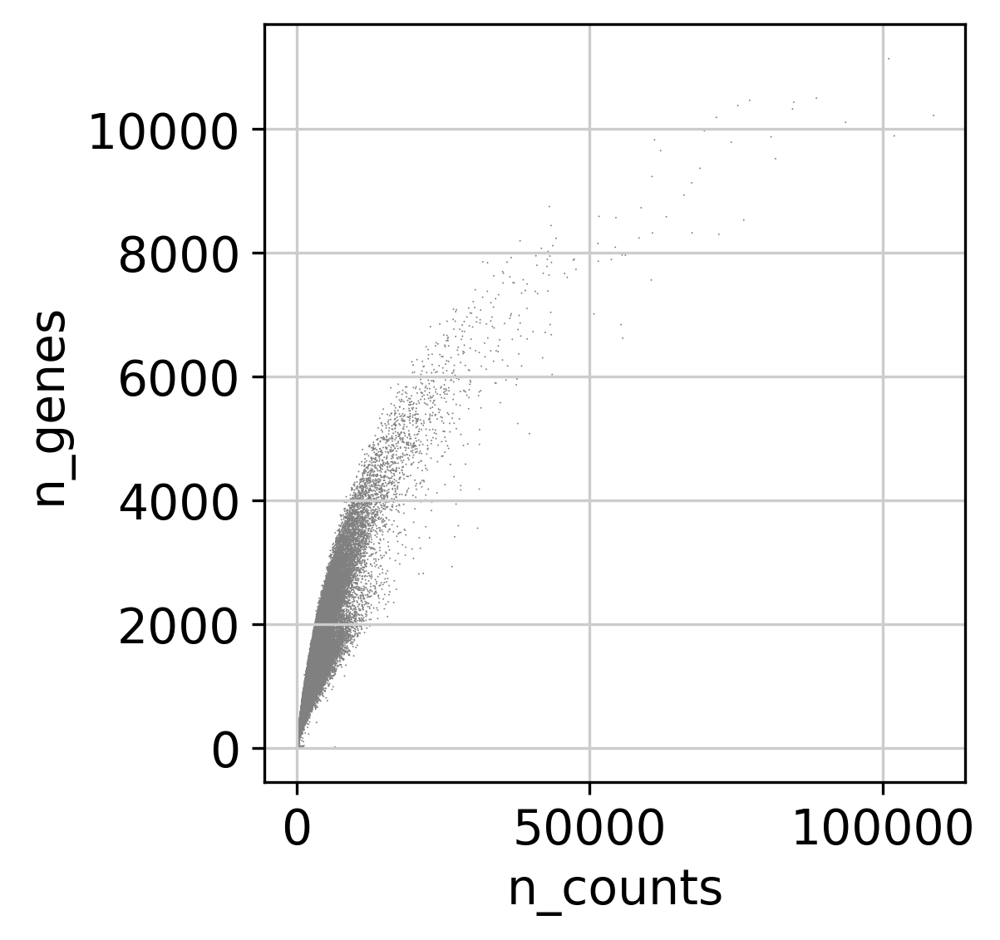

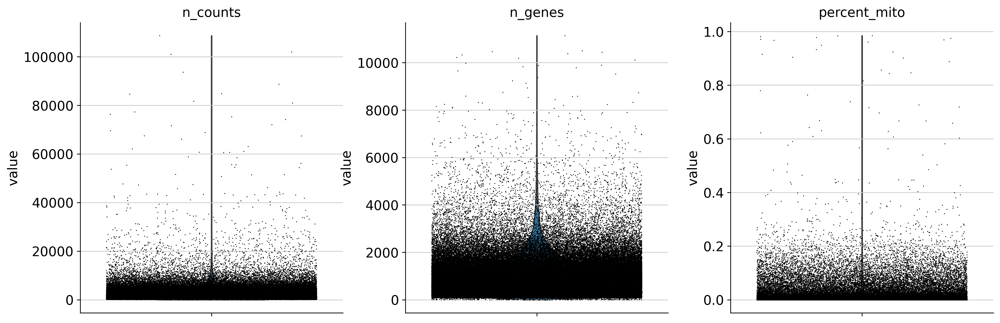

In [9]:
sc.pl.scatter(adata, x='n_counts', y='n_genes')
sc.pl.violin(adata, ['n_counts', 'n_genes', 'percent_mito'],
             jitter=0.4, multi_panel=True)

In [10]:
adata_qc = adata.copy()
# Filter raw cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_qc.n_obs))

np.quantile(adata.obs['n_counts'], [.99])
sc.pp.filter_cells(adata_qc, min_counts = 500)
print('Number of cells after min count filter: {:d}'.format(adata_qc.n_obs))

sc.pp.filter_cells(adata_qc, max_counts = 40000)
print('Number of cells after max count filter: {:d}'.format(adata_qc.n_obs))

np.quantile(adata.obs['n_genes'], [.99])
sc.pp.filter_cells(adata_qc, min_genes = 400)
print('Number of cells after min genes filter: {:d}'.format(adata_qc.n_obs))

sc.pp.filter_cells(adata_qc, max_genes = 5000)
print('Number of cells after max genes filter: {:d}'.format(adata_qc.n_obs))

adata_qc = adata_qc[adata_qc.obs['percent_mito'] < 0.05]
print('Number of cells after mito filter: {:d}'.format(adata_qc.n_obs))

Total number of cells: 138902


array([12579.93])

Number of cells after min count filter: 115620
Number of cells after max count filter: 115552


array([3947.])

Number of cells after min genes filter: 107754
Number of cells after max genes filter: 107275
Number of cells after mito filter: 104486


In [11]:
adata_qc = doublet_detection(sample_object = adata_qc, sample_col = 'SampleID', return_anndata = True)

(104486, 3)


In [12]:
np.mean(adata_qc.obs['is_doublet'])
np.mean(adata_qc.obs['scrublet_score']>0.4)

0.04895392684187355

0.022960013781750666

In [13]:
adata_qc.obs['SampleID'].value_counts()

WS_A_SKM9426500     10304
WS_A_SKM9426498      8472
mus_SNuc7468111      8435
WS_A_SKM9426497      8322
WS_A_SKM9426496      8313
5386STDY8552709      7379
5386STDY7645355      6627
WS_A_SKM9426502      6090
5386STDY8552614      6057
WS_A_SKM9426501      5770
5386STDY8552613      5345
5386STDY7600836      4586
5386STDY7600837      4382
WS_A_SKM9426495      4170
5386STDY8090407      2817
5386STDY8090406      2354
WS_A_SKM10691778     1862
5386STDY8493510      1462
WS_A_SKM9426499       605
WS_A_SKM10691779      521
5386STDY7796287       329
5386STDY7796286       284
Name: SampleID, dtype: int64

In [14]:
adata_qc.layers["counts"] = adata_qc.X.copy()
sc.pp.normalize_total(adata_qc, target_sum=1e4)
sc.pp.log1p(adata_qc)

In [15]:
adata = adata_qc.copy()

In [16]:
#List of genes /nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt
cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_qc.var_names]

sc.pp.scale(adata_qc)
sc.tl.score_genes_cell_cycle(adata_qc, s_genes, g2m_genes)

In [17]:
adata.obs[['S_score', 'G2M_score', 'phase']] = adata_qc.obs[['S_score', 'G2M_score', 'phase']].copy()
adata.write(f"updated_icm_snuclei/ICM_snuclei_data_qc_fin_{today}.h5ad")

In [20]:
adata.X.data


array([0.4662027, 0.4662027, 1.0230947, ..., 3.038826 , 3.038826 ,
       3.038826 ], dtype=float32)

In [24]:
#del adata_qc
import gc
gc.collect()

3726

## Run scvi integration

adata_scvi = adata.copy()
adata_scvi.layers["counts"] = adata_scvi.X.copy()
sc.pp.normalize_total(adata_scvi, target_sum=1e4)
sc.pp.log1p(adata_scvi)
 # keep full dimension safe
sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
                            batch_key="Age_group")

len(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+all_mrkrs))

selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+ all_mrkrs))
print(len(selected_genes))

cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
[selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]

len(cell_cycle_genes)

len(selected_genes)

In [25]:
def run_scvi(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = [], exclude_cc_genes=True, exclude_mt_genes = True, vae_name = "", **kwargs):
    adata_scvi = sc.AnnData(X = adata.layers['counts'].copy(), obs = adata.obs.copy(), var = adata.var.copy())
    #adata_scvi.layers["counts"] = adata_scvi.X.copy()
    #sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    #sc.pp.log1p(adata_scvi)
     # keep full dimension safe
#    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
#                                batch_key="Age_group")
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000,batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+ include_genes))
    print(len(selected_genes))
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
        [selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [selected_genes.remove(i) for i in mt_genes if i in selected_genes]
        
    adata_scvi = adata_scvi[:, selected_genes].copy()
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi, \
                             categorical_covariate_keys=cat_cov_scvi, \
                             continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k,v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
    train_kwargs = {k: v for k,v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
   # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
 #   adata_raw_scvi = adata.copy()
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi)
#   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)    
    
    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.obs['leiden'] = adata_scvi.obs['leiden'].copy()
    
    sc.pl.umap(
        adata_raw_scvi,
        color=["Age_group", "10X_version"],
        frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['n_counts', "percent_soup", "percent_spliced", 'percent_mito', 'percent_ribo', 'percent_hb', \
               'scrublet_score', 'is_doublet'])
    cat_cov_str = "-".join(cat_cov_scvi)
#    vae.save(f"/nfs/team205/vk8/scripts/scvi/Results/scvi_models/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return(results)

In [25]:
def run_scvi_upd(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = [], exclude_cc_genes=True, exclude_mt_genes = True, vae_name = "", **kwargs):
    adata_scvi = sc.AnnData(X = adata.layers['counts'].copy(), obs = adata.obs.copy(), var = adata.var.copy())
    #adata_scvi.layers["counts"] = adata_scvi.X.copy()
    #sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    #sc.pp.log1p(adata_scvi)
     # keep full dimension safe
#    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
#                                batch_key="Age_group")
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000,batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+ include_genes))
    print(len(selected_genes))
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
        [selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [selected_genes.remove(i) for i in mt_genes if i in selected_genes]
        
    adata_scvi = adata_scvi[:, selected_genes].copy()
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi, \
                             categorical_covariate_keys=cat_cov_scvi, \
                             continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k,v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
    train_kwargs = {k: v for k,v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
   # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
 #   adata_raw_scvi = adata.copy()
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi)
#   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)    
    
    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.uns = adata_scvi.uns.copy()
    adata_raw_scvi.obs['leiden'] = adata_scvi.obs['leiden'].copy()
    
    sc.pl.umap(
        adata_raw_scvi,
        color=["Age_group", "10X_version"],
        frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['n_counts', "percent_soup", "percent_spliced", 'percent_mito', 'percent_ribo', 'percent_hb', \
               'scrublet_score', 'is_doublet'])
    cat_cov_str = "-".join(cat_cov_scvi)
#    vae.save(f"/nfs/team205/vk8/scripts/scvi/Results/scvi_models/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return(results)

10019
INFO     Using batches from adata.obs["SampleID"]                                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 104486 cells, 9961 vars, 22       
         batches, 1 labels, and 0 proteins. Also registered 4 extra categorical covariates   
         and 1 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 639/1000:  64%|██████▍   | 639/1000 [1:28:56<50:15,  8.35s/it, loss=1.23e+03, v_num=1]  


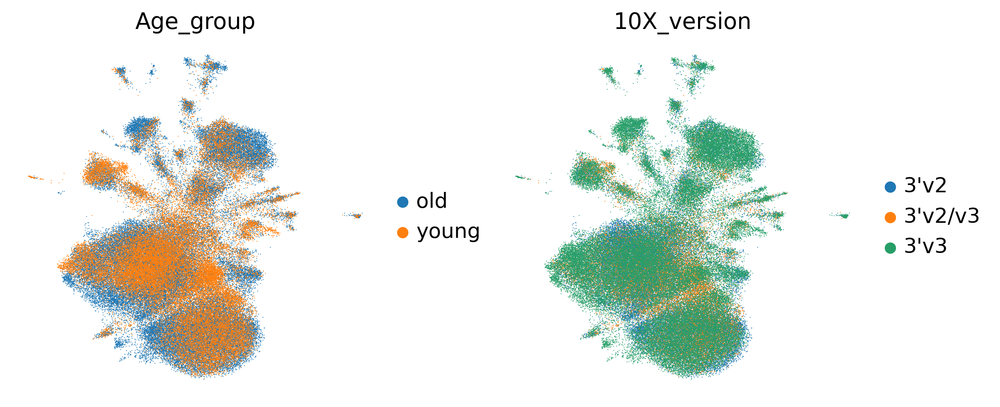

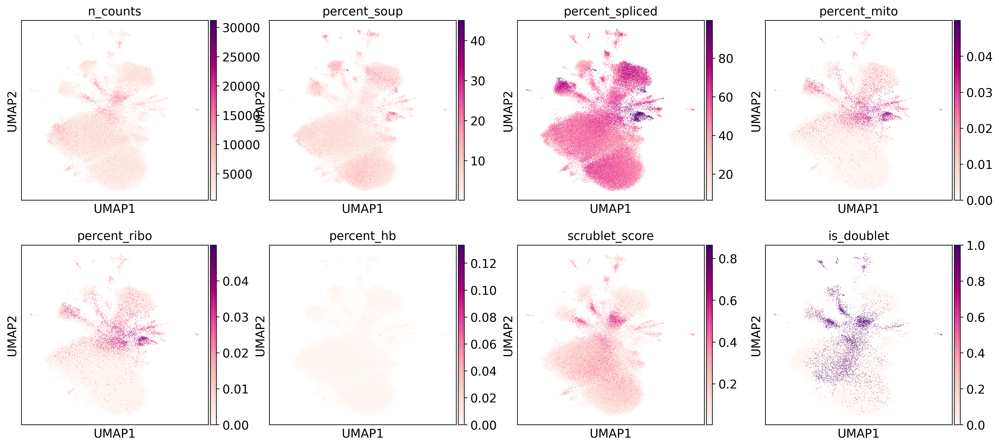

In [26]:
adata_scvi = run_scvi(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = all_mrkrs, exclude_cc_genes=True, exclude_mt_genes = True, 
                      vae_name = "ICM_snuclei_updated_v5", 
   n_hidden=512, n_layers=2, n_latent=50, gene_likelihood='nb', dispersion='gene-batch',use_observed_lib_size=False,
                           train_size=0.99, max_epochs=1000, batch_size=1024, early_stopping = True)

In [30]:
scvi_run = adata_scvi.copy()

In [31]:
del adata_scvi

In [32]:
adata_scvi = scvi_run['data']

In [36]:
scvi_run['vae'].adata.uns['neighbors']

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'n_neighbors': 15, 'method': 'umap', 'random_state': 0, 'metric': 'euclidean', 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [37]:
adata_scvi.uns = scvi_run['vae'].adata.uns.copy()

model = scvi.model.SCVI(
    adata,
    n_hidden=512,
    n_layers=2,
    n_latent=50,
    gene_likelihood='nb',
    dispersion='gene-batch',
    use_observed_lib_size=False,
)
model.train(
    train_size=0.99, 
    max_epochs=1000, 
    batch_size=1024,
)

In [38]:
import celltypist
import time
# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_fine = celltypist.annotate(adata_scvi, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_fine_new_2023-05-04.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi = predictions_cells_fine.to_adata(prefix = 'fine_')

# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_coarse = celltypist.annotate(adata_scvi, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_coarse_2023-03-06.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi = predictions_cells_coarse.to_adata(prefix = 'coarse_')

🔬 Input data has 104486 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 7700 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 104486 cells and 33538 genes
🔗 Matching reference genes in the model


Time elapsed: 209.65813422203064 seconds


🧬 7542 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!


Time elapsed: 220.40909671783447 seconds


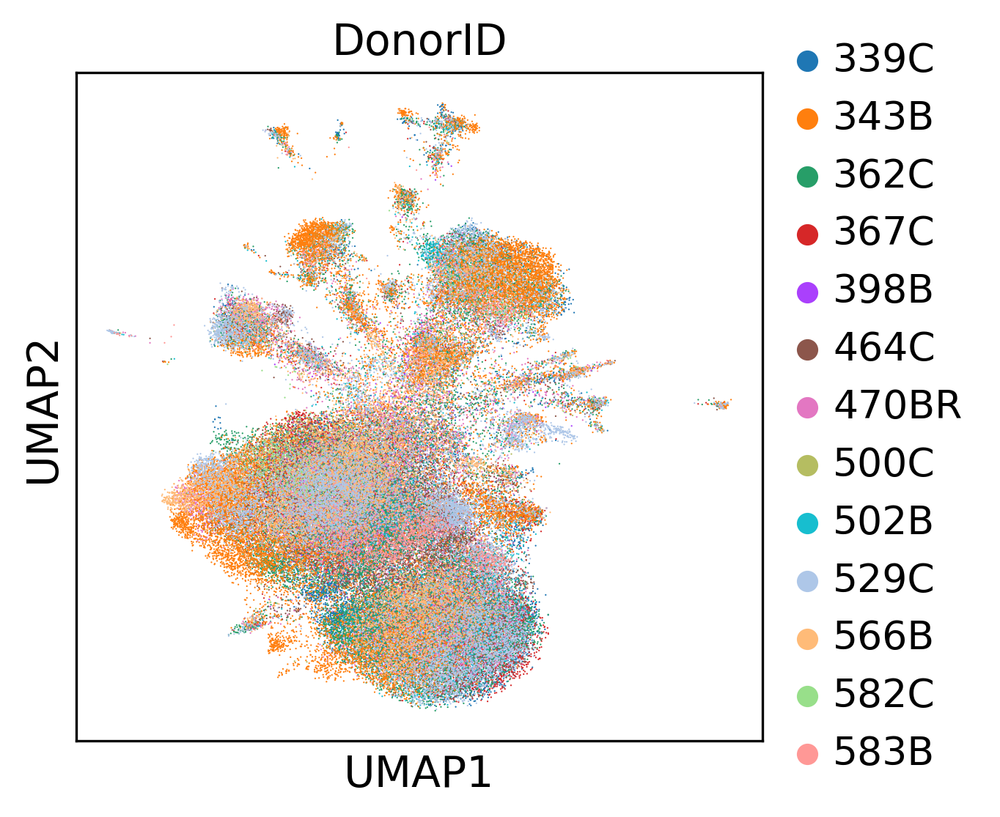

In [40]:
sc.pl.umap(adata_scvi, color = ['DonorID'])

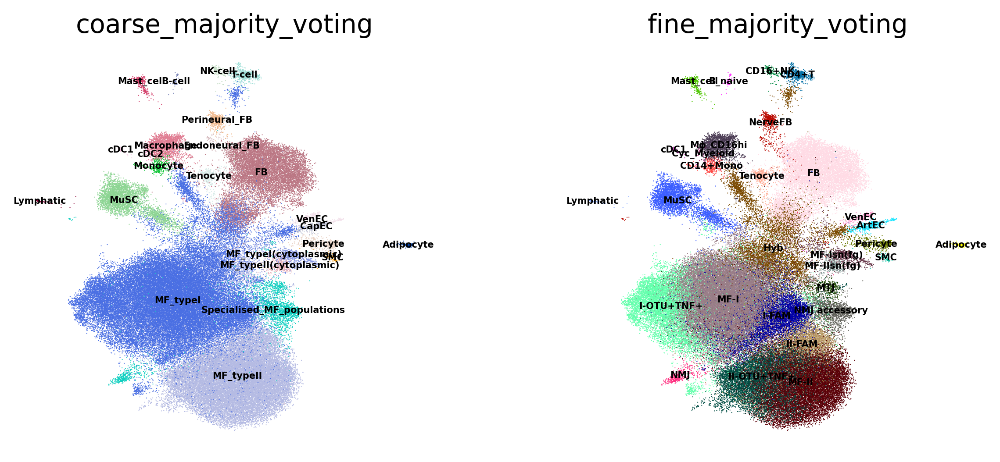

In [41]:
sc.pl.umap(adata_scvi, color = ["coarse_majority_voting", "fine_majority_voting"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [42]:
sc.tl.leiden(adata_scvi, resolution = 1.6, key_added = "leiden_r1.6")
sc.tl.leiden(adata_scvi, resolution = 2, key_added = "leiden_r2")
sc.tl.leiden(adata_scvi, resolution = 3, key_added = "leiden_r3")

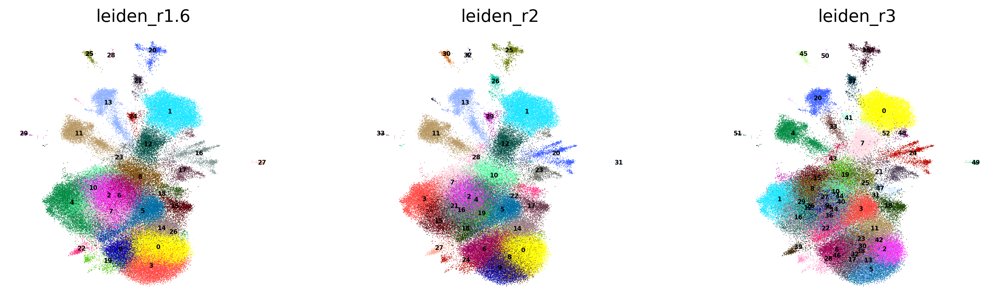

In [43]:
sc.pl.umap(adata_scvi, color = ["leiden_r1.6", "leiden_r2", "leiden_r3"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

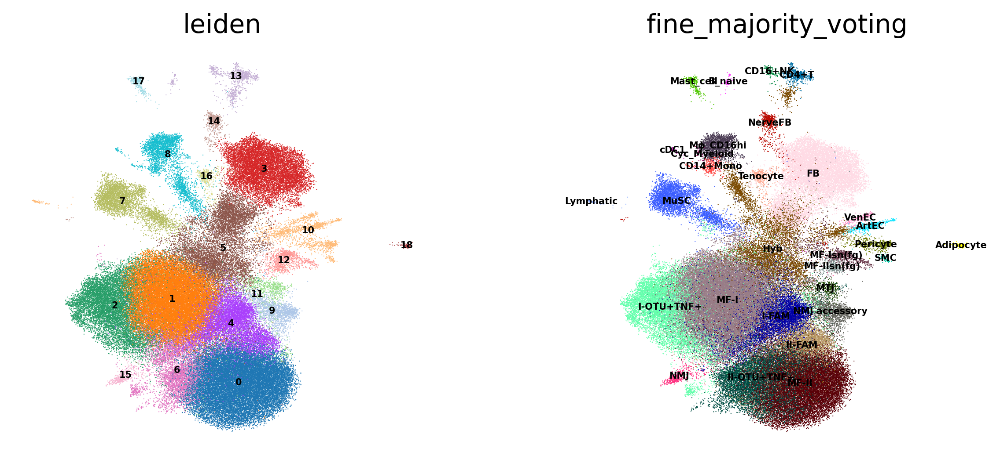

In [50]:
sc.pl.umap(adata_scvi, color = ["leiden", "fine_majority_voting"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [55]:
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden', ['7']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['8']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['10']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['13']], key_added = "leiden_r")

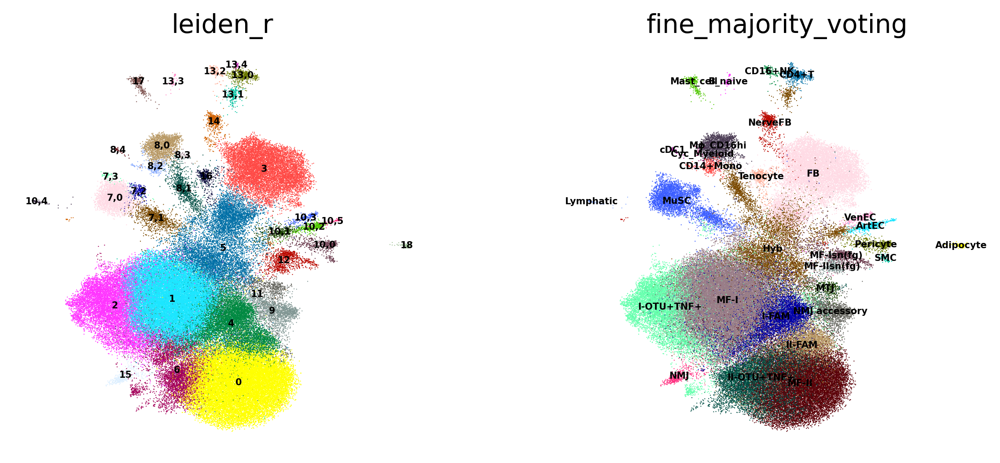

In [56]:
sc.pl.umap(adata_scvi, color = ["leiden_r", "fine_majority_voting"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [60]:
myofiber_doublets = ["5", "7,1", "8,1", "10,1", "13,1"]
adata_scvi.obs['manual_anno'] = adata_scvi.obs.apply(lambda x: 'Doublet' if x["leiden_r"] in myofiber_doublets else
                                     x["fine_majority_voting"], axis = 1)

... storing 'manual_anno' as categorical


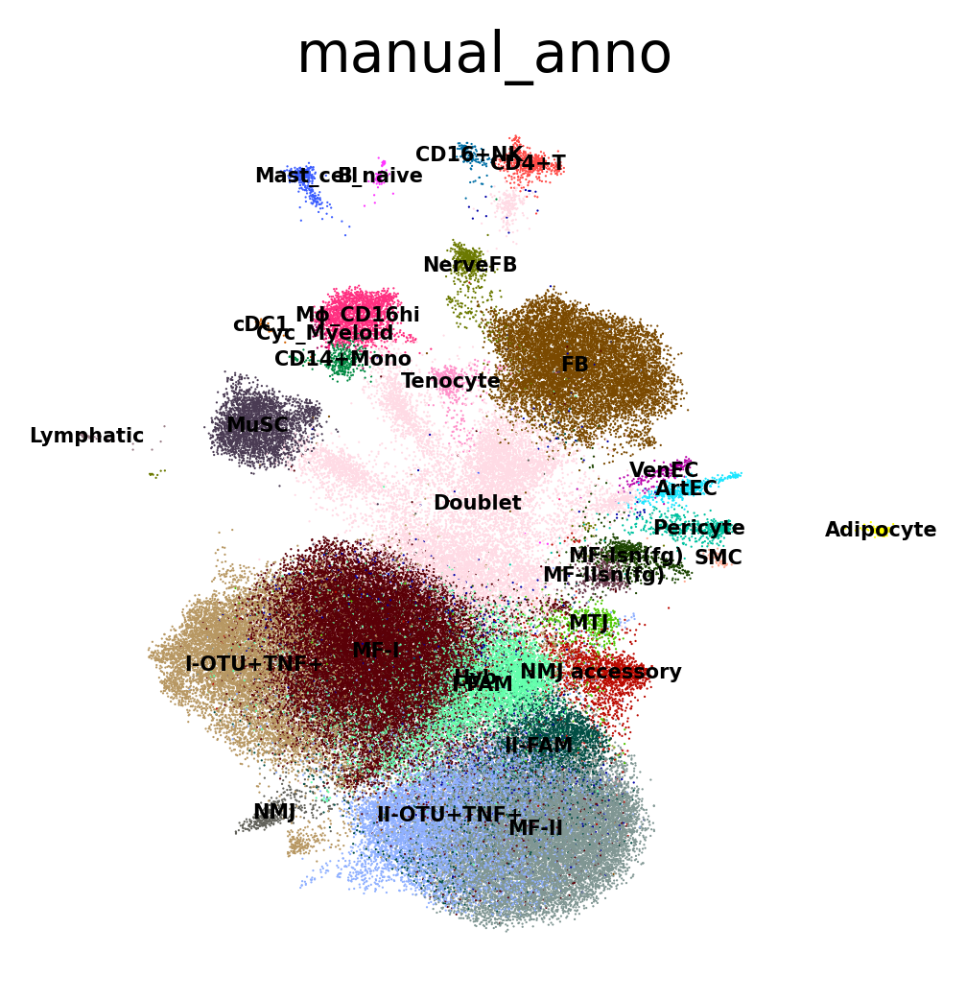

In [61]:
sc.pl.umap(adata_scvi, color = ["manual_anno"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [62]:
adata_scvi_dbrm = adata_scvi[adata_scvi.obs['manual_anno']!='Doublet',:].copy()

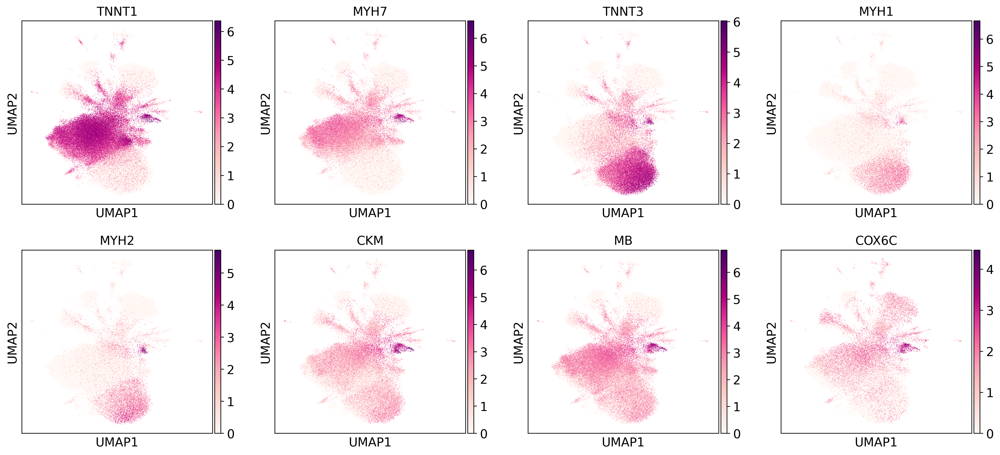

In [46]:
sc.pl.umap(adata_scvi, color = ['TNNT1','MYH7','TNNT3','MYH1','MYH2','CKM','MB','COX6C'])

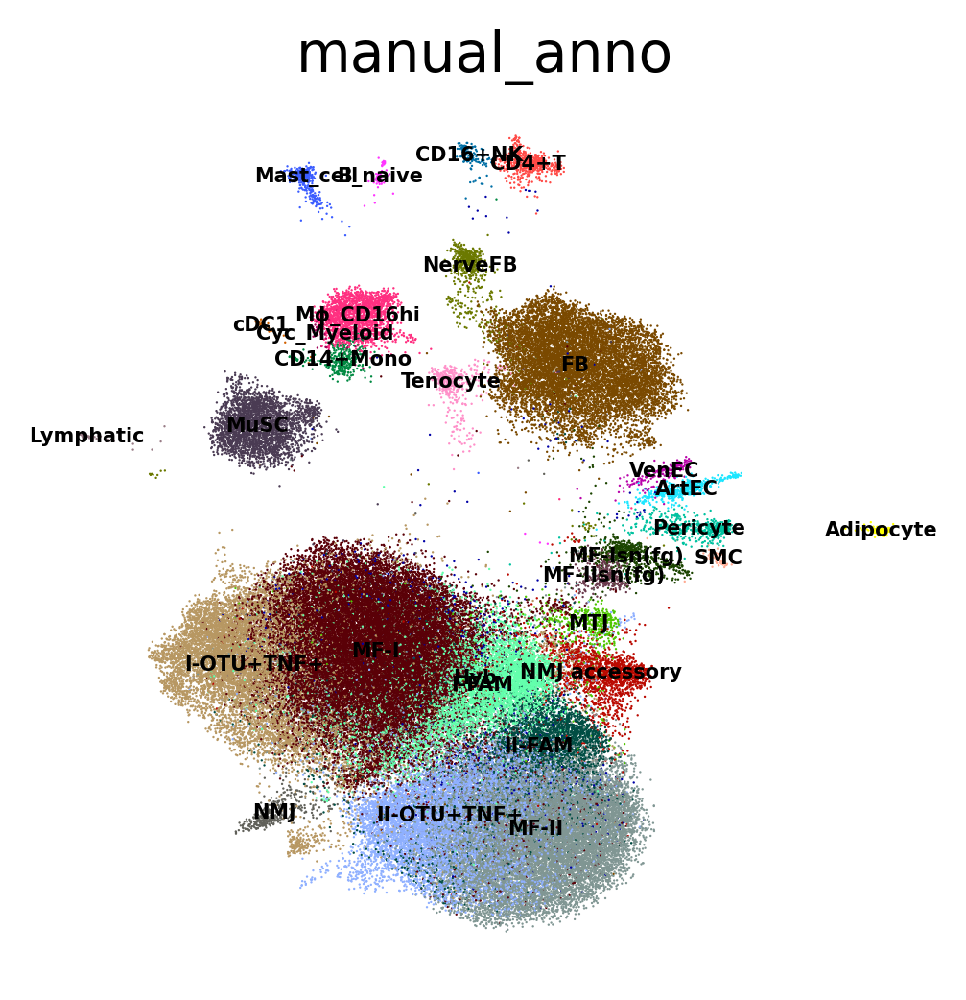

In [63]:
sc.pl.umap(adata_scvi_dbrm, color = ["manual_anno"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [ ]:
adata_scvi_dbrm.obsm["X_scVI1"] = adata_scvi_dbrm.obsm["X_scVI"].copy()
adata_scvi_dbrm.obsm["X_Umap1"] = adata_scvi_dbrm.obsm["X_umap"].copy()

sc.pp.neighbors(adata_scvi_dbrm, use_rep="X_scVI")
sc.tl.umap(adata_scvi_dbrm)

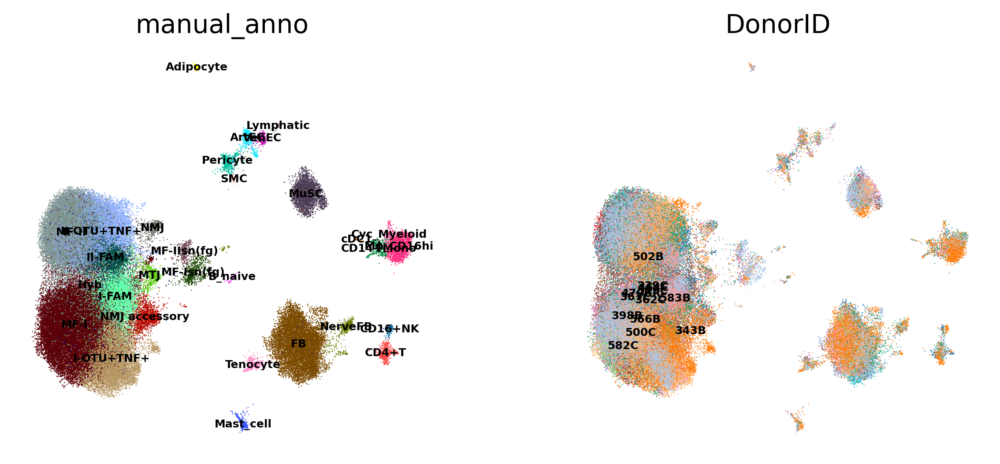

In [69]:
sc.pl.umap(adata_scvi_dbrm, color = ["manual_anno", "DonorID"], legend_loc = "on data", 
          legend_fontsize = 6, frameon = False)

In [66]:
adata_scvi_dbrm.obs['manual_anno'].cat.categories

Index(['Adipocyte', 'ArtEC', 'B_naive', 'CD4+T', 'CD14+Mono', 'CD16+NK',
       'Cyc_Myeloid', 'FB', 'Hyb', 'I-FAM', 'I-OTU+TNF+', 'II-FAM',
       'II-OTU+TNF+', 'Lymphatic', 'MF-I', 'MF-II', 'MF-IIsn(fg)',
       'MF-Isn(fg)', 'MTJ', 'Mast_cell', 'MuSC', 'Mϕ_CD16hi', 'NMJ',
       'NMJ accessory', 'NerveFB', 'Pericyte', 'SMC', 'Tenocyte', 'VenEC',
       'cDC1'],
      dtype='object')

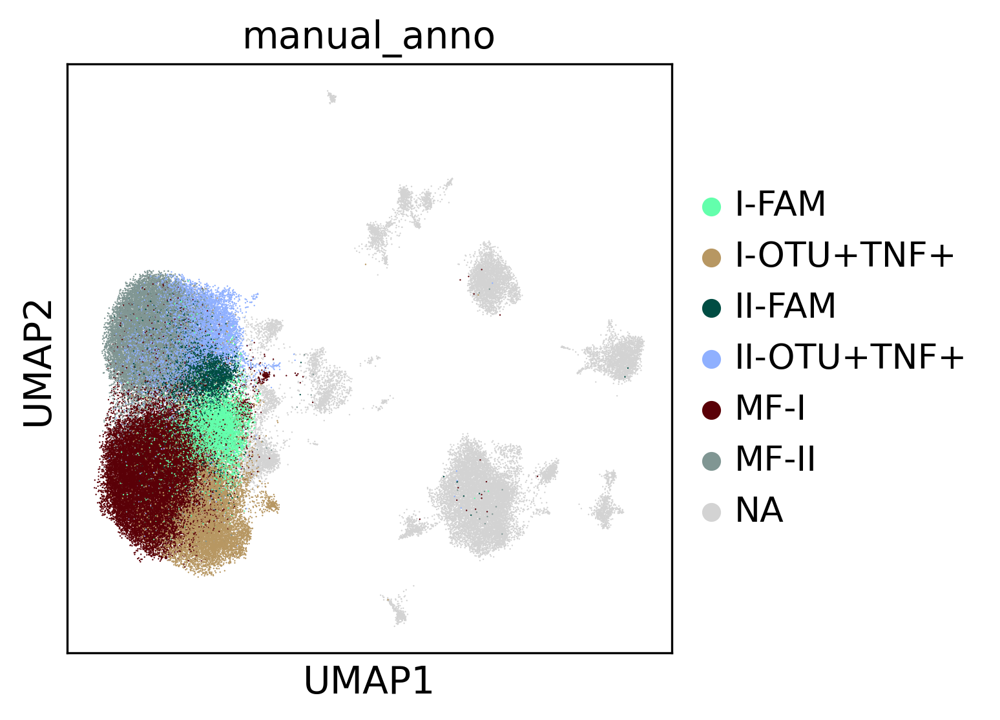

In [68]:
sc.pl.umap(adata_scvi_dbrm, color = 'manual_anno', groups = ['MF-I', 'I-FAM', 'I-OTU+TNF+', 
                                                             'MF-II', 'II-FAM', 'II-OTU+TNF+'])

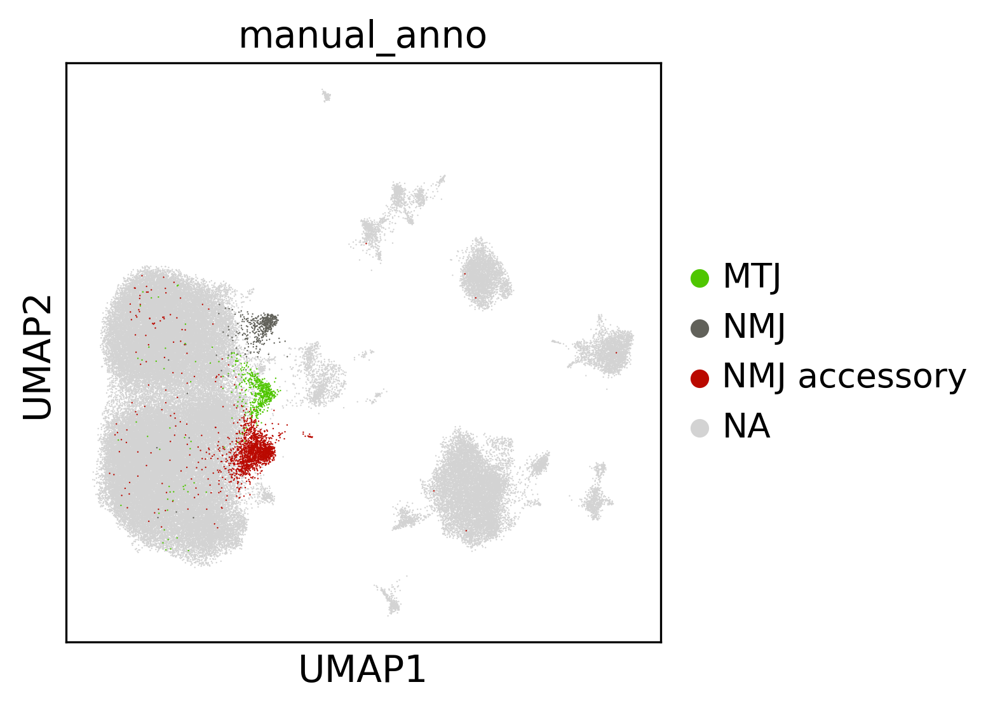

In [70]:
sc.pl.umap(adata_scvi_dbrm, color = 'manual_anno', groups = ['NMJ', 'MTJ', 'NMJ accessory'])

In [88]:
adata_scvi_dbrm.obs['manual_anno'].cat.categories

Index(['Adipocyte', 'ArtEC', 'B_naive', 'CD4+T', 'CD14+Mono', 'CD16+NK',
       'Cyc_Myeloid', 'FB', 'Hyb', 'I-FAM', 'I-OTU+TNF+', 'II-FAM',
       'II-OTU+TNF+', 'Lymphatic', 'MF-I', 'MF-II', 'MF-IIsn(fg)',
       'MF-Isn(fg)', 'MTJ', 'Mast_cell', 'MuSC', 'Mϕ_CD16hi', 'NMJ',
       'NMJ accessory', 'NerveFB', 'Pericyte', 'SMC', 'Tenocyte', 'VenEC',
       'cDC1'],
      dtype='object')

In [80]:
len(adata_scvi_dbrm.obs['manual_anno'].cat.categories)

30

In [90]:
ctype_dict_fine = {'MuSC': ['MuSC'],
    'Myofiber':['MF-I', 'I-FAM', 'I-OTU+TNF+','MF-II', 'II-FAM', 'II-OTU+TNF+','NMJ', 'MTJ', 'NMJ accessory',
               'MF-IIsn(fg)','MF-Isn(fg)', 'Hyb'],
    'Fb': ['FB', 'Tenocyte', 'NerveFB',],
    'Vasculature': ['ArtEC','VenEC', 'Lymphatic', 'Pericyte', 'SMC'], 
    'Myeloid': ['CD14+Mono', 'Cyc_Myeloid','Mϕ_CD16hi','cDC1'], 
    'TNKcells': ['CD16+NK','CD4+T'], 
    'Bcell': ['B_naive'],
    'Mast_cell' : ['Mast_cell'],
    'Adipocyte': ['Adipocyte'],
              
     }


In [91]:
ctype_list = []
[ctype_list.extend(i) for i in ctype_dict_fine.values()]

[None, None, None, None, None, None, None, None, None]

In [92]:
[i for i in adata_scvi_dbrm.obs['manual_anno'].cat.categories if i not in ctype_list]

[]

In [97]:
adata_scvi_dbrm.X.data
adata_scvi_dbrm.layers['counts'].data

array([0.50827867, 0.8436574 , 0.50827867, ..., 3.038826  , 3.038826  ,
       3.038826  ], dtype=float32)

array([1., 2., 1., ..., 1., 1., 1.], dtype=float32)

In [98]:
for key,val in ctype_dict_fine.items():
    cells = adata_scvi_dbrm[adata_scvi_dbrm.obs['fine_majority_voting'].isin(val),:].obs_names
    adata_ctype = adata_scvi_dbrm[cells,:].copy()
    adata_ctype.write(f"updated_icm_snuclei/ICM_{key}_raw_{today}_fine.h5ad")

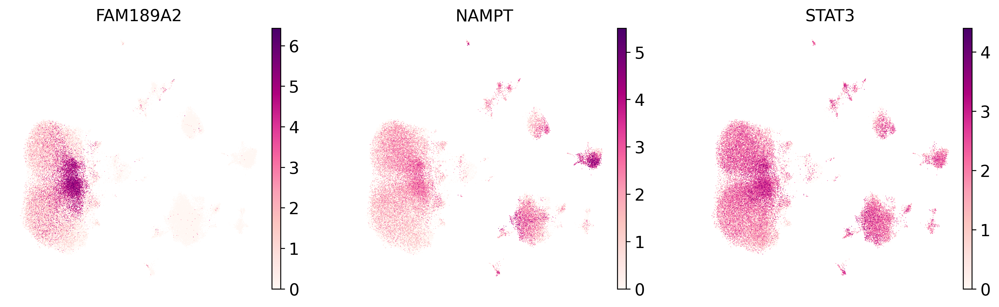

In [99]:
sc.pl.umap(adata_scvi_dbrm, color = ['FAM189A2', 'NAMPT', 'STAT3'], frameon = False, legend_loc = "on data", legend_fontsize = 5)

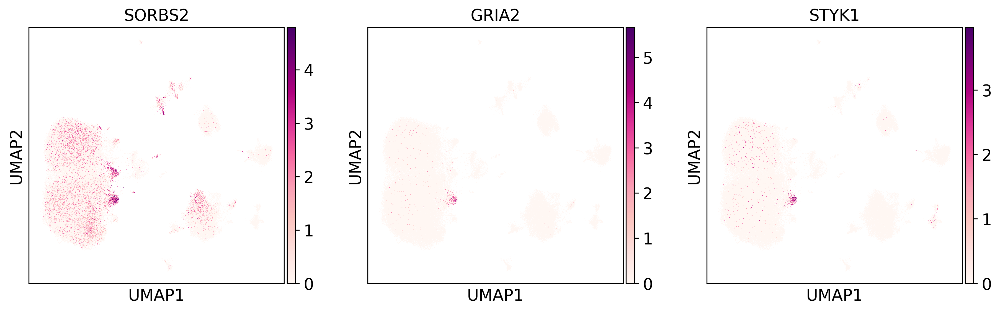

In [101]:
sc.pl.umap(adata_scvi_dbrm, color = ['SORBS2', 'GRIA2', 'STYK1'])

In [4]:
adata_scvi_no_cc_dbrm_raw = sc.read("SKM_nuclei_raw_scvi_dbrm_2023-04-04.h5ad")

In [102]:
def calcul_plot_prop_box2(adata_input, ctype_anno, sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_bin", filt_samples=True, subset_rm=[], subset_sel=[], pairs=[],
                          plot_save='', save_dir=''):
    if filt_samples == True:
        samples = adata_input.obs['SampleID'].value_counts().index[adata_input.obs['SampleID'].value_counts() > 1000]
        adata_obs = adata_input.obs.loc[adata_input.obs['SampleID'].isin(samples), :].copy()
    else:
        adata_obs = adata_input.obs.copy()

    if len(subset_rm) > 0:
        adata_obs = adata_obs.loc[~adata_obs[ctype_anno].isin(subset_rm)].copy()

    adata_obs[ctype_anno].cat.remove_unused_categories(inplace=True)
    sample2pop = adata_obs.groupby([sample_anno, ctype_anno]).count()[['n_counts']] / \
                 adata_obs.groupby([sample_anno]).count()[['n_counts']]
    sample2pop.reset_index(inplace=True)
    if len(subset_sel) > 0:
        sample2pop = sample2pop.loc[sample2pop[ctype_anno].isin(subset_sel)].copy()
        sample2pop[ctype_anno].cat.remove_unused_categories(inplace=True)
        sample2pop[ctype_anno] = sample2pop[ctype_anno].cat.reorder_categories(subset_sel).copy()
    age2donor2sample = adata_obs[[age_group, donor_anno, sample_anno]][
        ~adata_obs[[age_group, donor_anno, sample_anno]].duplicated()]
    age2d2s2ctype = age2donor2sample.merge(sample2pop, how="left", left_on=sample_anno, right_on=sample_anno)
    d2ctype = age2d2s2ctype.groupby([donor_anno, ctype_anno]).mean()['n_counts'].reset_index()
    age2donor = age2d2s2ctype[[age_group, donor_anno]][
        ~age2d2s2ctype[[age_group, donor_anno]].duplicated()].reset_index(drop=True)
    age2d2ctype = age2donor.merge(d2ctype, how="left", left_on=donor_anno, right_on=donor_anno)
    age2d2ctype[age_group] = age2d2ctype[age_group].cat.reorder_categories(['young', 'old'])
    with matplotlib.rc_context({'axes.facecolor': 'black'}):
        rcParams['pdf.fonttype'] = 42
        rcParams['figure.figsize'] = [4, 4]
        import seaborn as sns
        sns.set_style(style="ticks")
        sns.set_context("paper")
        # sns.set_style("ticks", {"xtick.major.size": 8, "ytick.major.size": 8})
        # sns.set_style("ticks")
        # Draw a nested barplot by species and sex
        bp = sns.boxplot(
            data=age2d2ctype,
            x=ctype_anno, y="n_counts", hue=age_group, linewidth=1.5,
            # notch=True,
            # showcaps=False,
            flierprops={"marker": "x"},
            #   boxprops={"facecolor": (.4, .6, .8, .5)},
            medianprops={"color": "black"},
        )
        # 'MF_typeI', 'MF_typeII', 'MF_typeI-FAM189A2','MF_typeII-FAM189A2', 'MF_typeI-OTUD1', 'MF_typeII-OTUD1',
        # 'MF_typeII-TNFRSF12A-high'
        if len(pairs) == 0:
            pairs = []
            for i in age2d2ctype[ctype_anno].cat.categories:
                x = ((i, age2d2ctype[age_group].cat.categories[0]), (i, age2d2ctype[age_group].cat.categories[1]))
                pairs.append(x)
        from statannotations.Annotator import Annotator
        annot = Annotator(bp, pairs, data=age2d2ctype, x=ctype_anno, y="n_counts", hue=age_group)
        annot.configure(test='Mann-Whitney', comparisons_correction="BH", verbose=2)
        annot.apply_test()
        ax, test_results = annot.annotate()
        plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
        #        print(test_results)
        list_of_dict = []
        for i in range(0, len(test_results)):
            list_of_dict.append(test_results[i].data.__dict__)
        signif_tb = pd.DataFrame(list_of_dict)
        #       annot = Annotator(ax, [("Thur", "Fri"), ("Thur", "Sat"), ("Fri", "Sun")], data=df, x=x, y=y, order=order)
        #       annot.configure(test='Mann-Whitney', text_format='star', loc='outside', verbose=2)
        #       annot.apply_test()
        #       ax, test_results = annot.annotate()

        IZ_colors = ['#000000', "#ff0000"]
        bp = sns.stripplot(
            data=age2d2ctype, dodge=True, jitter=True, marker="D", alpha=1,
            x=ctype_anno, y="n_counts", hue=age_group, palette=IZ_colors, s=3,
        )
        plt.xticks(rotation=90)
        # bp.despine()
        # g.set_xticklabels(g.get_xticklabels(), rotation=30)
        # bp.set_axis_labels("", "Proportion of myofiber type")
        handles, labels = bp.get_legend_handles_labels()
        # specify just one legend
        l = plt.legend(handles[0:2], labels[0:2])
        # bp.legend.set_title("")
        plt.tight_layout()
        if len(plot_save) > 0:
            plt.savefig(f'{save_dir}/Boxplot2_{plot_save}.pdf', dpi=300, bbox_inches='tight')
        output = {'df': age2d2ctype, 'test_res': signif_tb}
    return (output)

In [103]:
adata_scvi_dbrm.obs.columns

Index(['SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age',
       'Species', 'Operator', 'Sample', '10X_version', 'n_counts',
       'n_counts_raw', 'percent_soup', 'n_counts_spliced',
       'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito',
       'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score',
       'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score',
       'G2M_score', 'phase', 'leiden', 'fine_predicted_labels',
       'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score',
       'coarse_predicted_labels', 'coarse_over_clustering',
       'coarse_majority_voting', 'coarse_conf_score', 'leiden_r1.6',
       'leiden_r2', 'leiden_r3', 'leiden_r', 'manual_anno'],
      dtype='object')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

I-FAM_young vs. I-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.497e-02 (ns) U_stat=3.600e+01
I-OTU+TNF+_young vs. I-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=2.700e+01
II-FAM_young vs. II-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.375e-01 U_stat=3.200e+01
II-OTU+TNF+_young vs. II-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=1.600e+01
Lymphatic_young vs. Lymphatic_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.862e-01 U_stat=2.250e+01
MF-I_young vs. MF-I_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_s

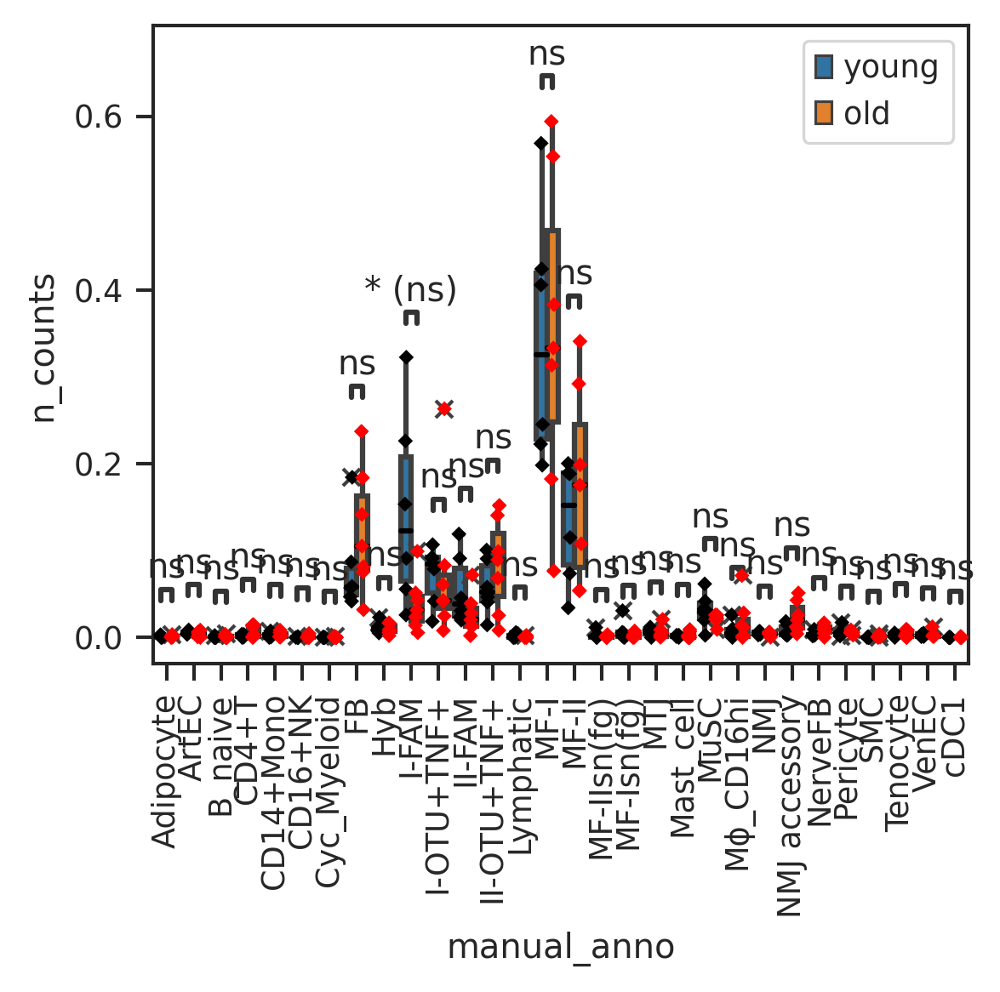

In [104]:
icm_d2c = calcul_plot_prop_box2(adata_scvi_dbrm, ctype_anno = "manual_anno", sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=[], subset_sel=[], pairs=[],
                          plot_save='', save_dir='')

In [105]:
adata_scvi_dbrm.obs['manual_anno'].cat.categories

Index(['Adipocyte', 'ArtEC', 'B_naive', 'CD4+T', 'CD14+Mono', 'CD16+NK',
       'Cyc_Myeloid', 'FB', 'Hyb', 'I-FAM', 'I-OTU+TNF+', 'II-FAM',
       'II-OTU+TNF+', 'Lymphatic', 'MF-I', 'MF-II', 'MF-IIsn(fg)',
       'MF-Isn(fg)', 'MTJ', 'Mast_cell', 'MuSC', 'Mϕ_CD16hi', 'NMJ',
       'NMJ accessory', 'NerveFB', 'Pericyte', 'SMC', 'Tenocyte', 'VenEC',
       'cDC1'],
      dtype='object')

In [106]:
major_pops = ['MF-I', 'MF-II', 'Hyb', 'MF-Isn(fg)', 'MF-IIsn(fg)', 'I-FAM', 'II-FAM', 'I-OTU+TNF+', 'II-OTU+TNF+']
sel_pops = ['NMJ', 'MTJ', 'NMJ accessory']
rm_ctypes = ['Hyb', 'MF-Isn(fg)', 'MF-IIsn(fg)']

imm_pops = ['Mϕ_CD16hi',  'CD14+Mono', 'CD16+Mono', 'CD4+T', 'Mast_cell', 'B-plasma', 'cDC1']
vasc_pops = ['ArtEC', 'VenEC', 'Lymphatic', 'Pericyte', 'SMC']
musc_fb = ['MuSC', 'FB']

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

II-OTU+TNF+_young vs. II-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=1.600e+01
MF-II_young vs. MF-II_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.308e-01 U_stat=1.800e+01
MF-I_young vs. MF-I_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.200e+01
Hyb_young vs. Hyb_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=2.700e+01
MF-Isn(fg)_young vs. MF-Isn(fg)_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.672e-01 U_stat=2.550e+01
MF-IIsn(fg)_young vs. MF-IIsn(fg)_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.000e+00 U_stat=2.1

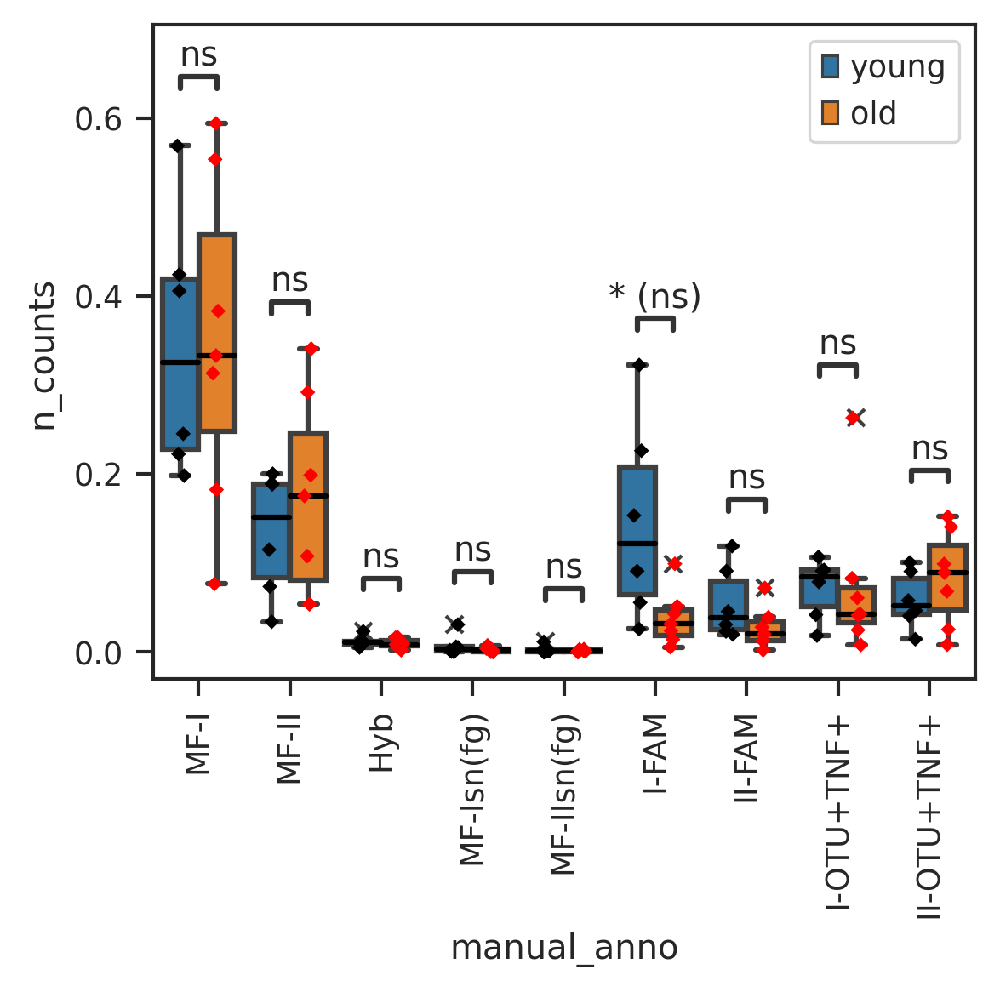

In [107]:
icm_d2c_major = calcul_plot_prop_box2(adata_scvi_dbrm, ctype_anno = "manual_anno", sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=[], subset_sel=major_pops, pairs=[],
                          plot_save='', save_dir='')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MF-II_young vs. MF-II_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.308e-01 U_stat=1.800e+01
MF-I_young vs. MF-I_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.200e+01
I-FAM_young vs. I-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.497e-02 (ns) U_stat=3.600e+01
II-FAM_young vs. II-FAM_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.375e-01 U_stat=3.200e+01
I-OTU+TNF+_young vs. I-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.452e-01 U_stat=2.700e+01
II-OTU+TNF+_young vs. II-OTU+TNF+_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.338e-01 U_stat=1.60

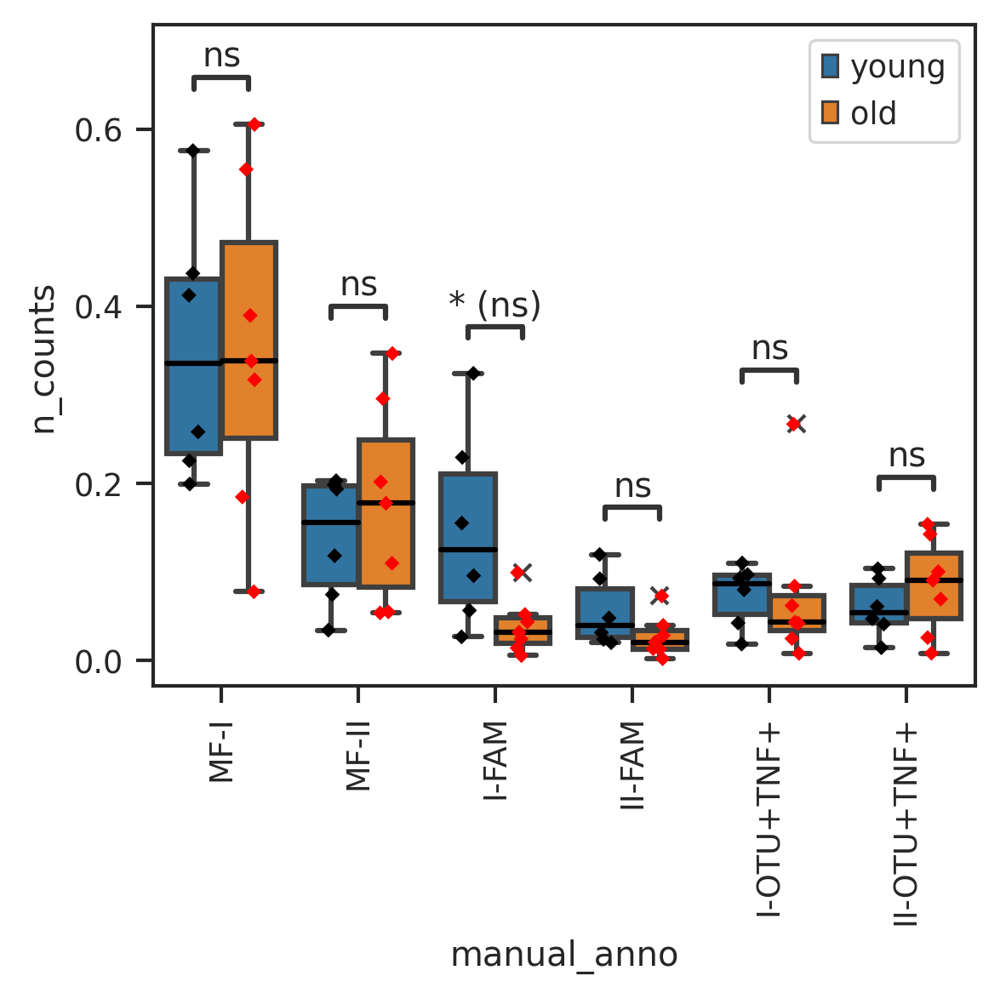

In [110]:
icm_d2c_major = calcul_plot_prop_box2(adata_scvi_dbrm, ctype_anno = "manual_anno", sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=rm_ctypes, subset_sel=
                                      ['MF-I', 'MF-II', 'I-FAM', 'II-FAM', 'I-OTU+TNF+', 'II-OTU+TNF+'], pairs=[],
                          plot_save='', save_dir='')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MTJ_young vs. MTJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.357e-01 U_stat=2.300e+01
NMJ_young vs. NMJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.200e+01
NMJ accessory_young vs. NMJ accessory_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.128e-02 U_stat=7.000e+00


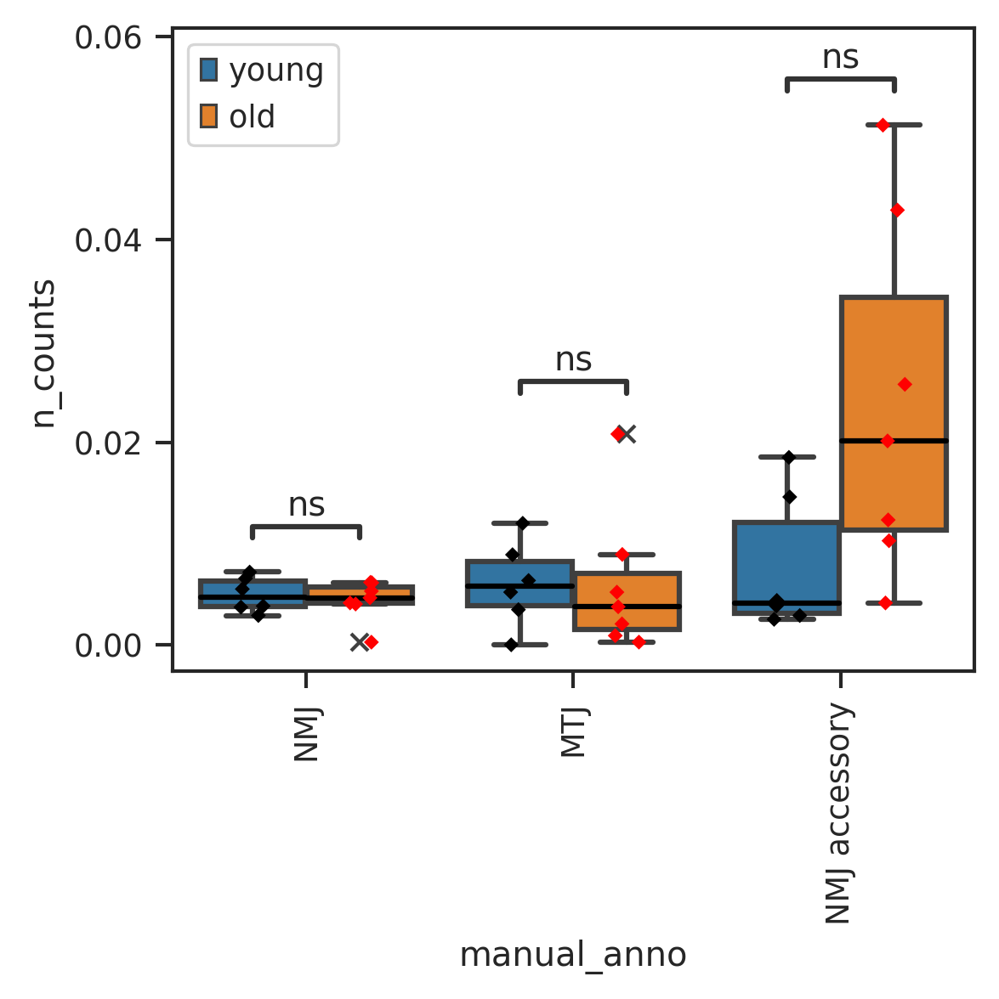

In [108]:
icm_d2c_nmj = calcul_plot_prop_box2(adata_scvi_dbrm, ctype_anno = "manual_anno", sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=[], subset_sel=sel_pops, pairs=[],
                          plot_save='', save_dir='')

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

MTJ_young vs. MTJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.308e-01 U_stat=2.400e+01
NMJ_young vs. NMJ_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.452e-01 U_stat=2.200e+01
NMJ accessory_young vs. NMJ accessory_old: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.128e-02 U_stat=7.000e+00


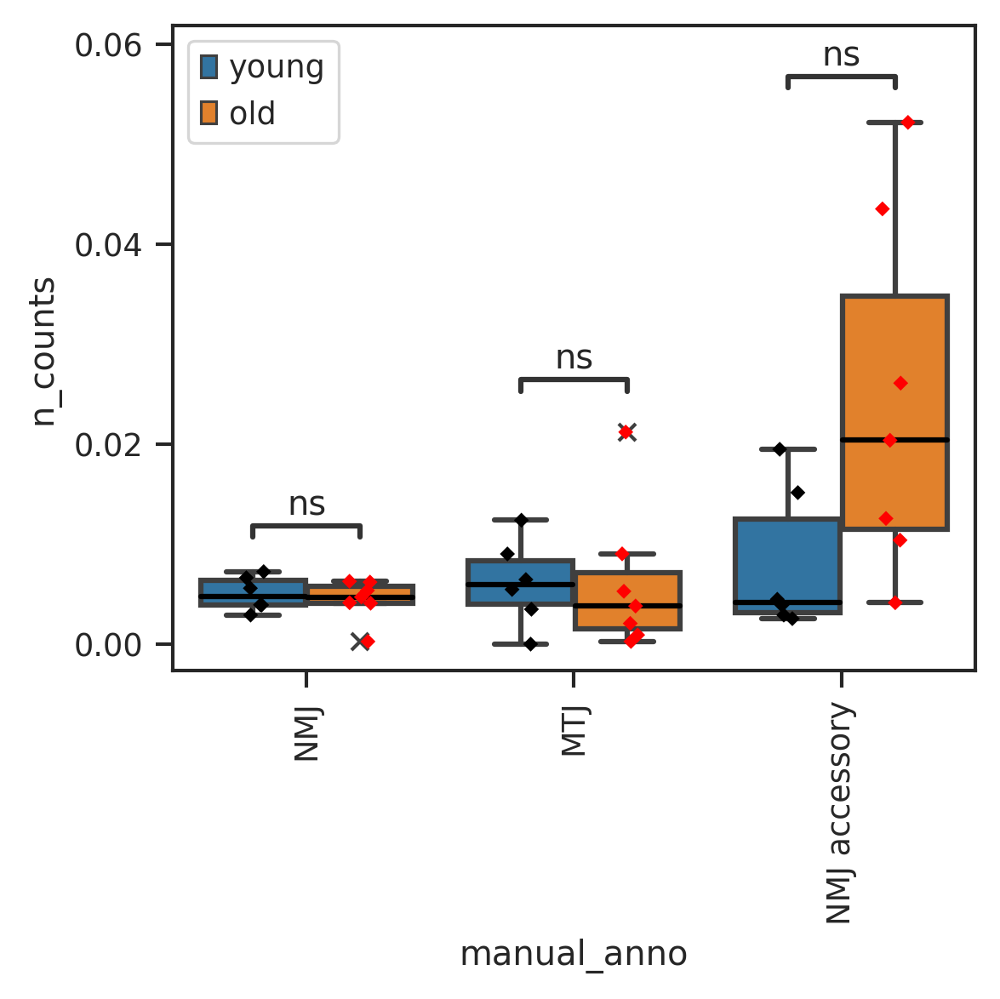

In [111]:
icm_d2c_nmj = calcul_plot_prop_box2(adata_scvi_dbrm, ctype_anno = "manual_anno", sample_anno="SampleID", donor_anno="DonorID",
                          age_group="Age_group", filt_samples=False, subset_rm=rm_ctypes, subset_sel=sel_pops, pairs=[],
                          plot_save='', save_dir='')

### Save outputs

In [114]:
adata_scvi_dbrm.obs['DonorID'].value_counts()

362C     15866
343B     14933
529C     10812
470BR    10706
464C     10438
566B      9046
339C      7741
367C      5966
502B      3777
583B      1730
500C      1298
582C       484
398B       408
Name: DonorID, dtype: int64

In [119]:
results = '/nfs/team205/vk8/processed_data/muscle/data_v3/updated_icm_snuclei'

vae = scvi_run['vae']

In [120]:
adata_scvi.shape
adata_scvi_dbrm.shape

(104486, 33538)

(93205, 33538)

In [121]:
adata_scvi.write(f'{results}/ICM_snuclei_data_scvi1_{today}.h5ad')
adata_scvi_dbrm.write(f'{results}/ICM_snuclei_data_scvi1_dbrm_{today}.h5ad')

In [122]:
model_folder = '/nfs/team205/vk8/scripts/scvi/Results/scvi_models/'
vae.save(f'{model_folder}/ICM_snuclei_data_scvi1_{today}',  save_anndata = True)

## Combine object after subcluster annotation

In [131]:
stroma_anno = pd.read_csv("updated_icm_snuclei/SKM_nuclei_stroma_anno_2023-05-07.csv", index_col=0)
myofiber_anno = pd.read_csv("updated_icm_snuclei/SKM_nuclei_myofiber_anno_2023-05-07.csv", index_col =0)

In [132]:
new_anno = pd.concat([stroma_anno, myofiber_anno])
adata_scvi_dbrm.obs['manual_anno2'] = new_anno.reindex(adata_scvi_dbrm.obs_names)['manual_anno2']

... storing 'manual_anno2' as categorical


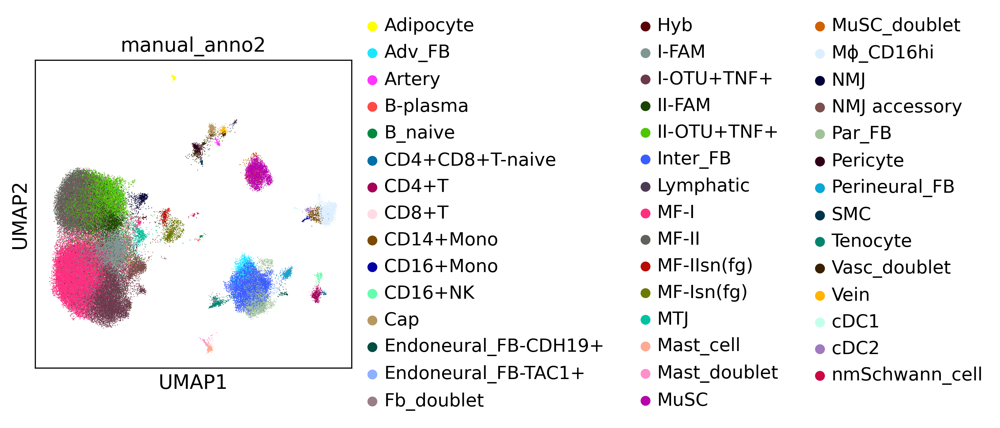

In [134]:
sc.pl.umap(adata_scvi_dbrm, color = ['manual_anno2'])

In [136]:
doublet_cl = [i for i in adata_scvi_dbrm.obs['manual_anno2'].cat.categories if 'doublet' in i]

In [138]:
adata_scvi_dbrm2 = adata_scvi_dbrm[~adata_scvi_dbrm.obs['manual_anno2'].isin(doublet_cl),:].copy()

In [137]:
doublet_cl

['Fb_doublet', 'Mast_doublet', 'MuSC_doublet', 'Vasc_doublet']

In [139]:
adata_scvi_dbrm.shape
adata_scvi_dbrm2.shape

(93205, 33538)

(92259, 33538)

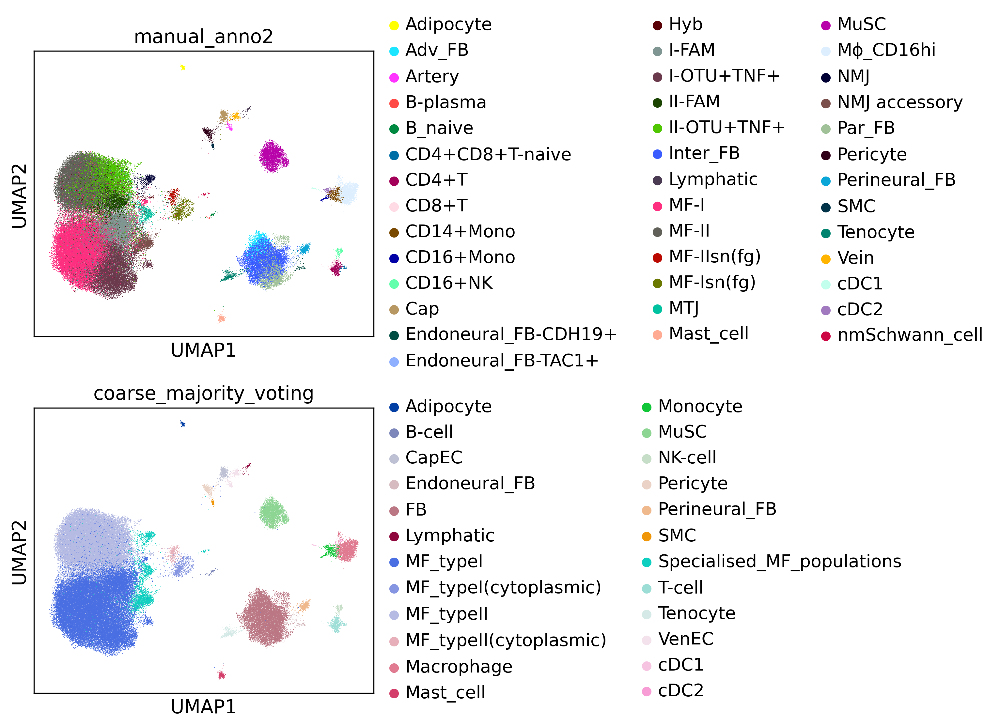

In [144]:
sc.pl.umap(adata_scvi_dbrm2, color = ['manual_anno2', 'coarse_majority_voting'], ncols = 1)

In [154]:
adata_scvi_dbrm2.obs['manual_anno2'].cat.categories = ['Adipocyte', 'Adv_FB', 'ArtEC', 'B-plasma', 'B_naive',
       'CD4+CD8+T-naive', 'CD4+T', 'CD8+T', 'CD14+Mono', 'CD16+Mono',
       'CD16+NK', 'Cap', 'Endoneural_FB-CDH19+', 'Endoneural_FB-TAC1+', 'Hyb',
       'I-FAM', 'I-OTU+TNF+', 'II-FAM', 'II-OTU+TNF+', 'Inter_FB', 'Lymphatic',
       'MF-I', 'MF-II', 'MF-IIsn(fg)', 'MF-Isn(fg)', 'MTJ', 'Mast_cell',
       'MuSC', 'Mϕ_CD16hi', 'NMJ', 'NMJ_accessory', 'Par_FB', 'Pericyte',
       'Perineural_FB', 'SMC', 'Tenocyte', 'Vein', 'cDC1', 'cDC2',
       'nmSchwann_cell']

In [155]:
adata_scvi_dbrm2.obs['annotation_level1'] = adata_scvi_dbrm2.obs['manual_anno2'].copy()

In [157]:
adata_scvi_dbrm2.obs['annotation_level0'] = adata_scvi_dbrm2.obs['annotation_level1'].apply( lambda x: 
'B-cell' if x == 'B_naive' else
'T-cell' if x in ['CD4+CD8+T-naive', 'CD4+T', 'CD8+T'] else
'NK-cell' if x == 'CD16+NK' else
'Monocyte' if x in ['CD14+Mono', 'CD16+Mono'] else
'Macrophage' if x =='Mϕ_CD16hi' else
'CapEC' if x == 'Cap' else
'Endoneural_FB' if x in ['Endoneural_FB-CDH19+', 'Endoneural_FB-TAC1+'] else
'MF_typeI' if x in ['MF-I', 'I-FAM', 'I-OTU+TNF+',] else
'MF_typeII' if x in ['MF-II', 'II-FAM', 'II-OTU+TNF+'] else
'Speacialised_MF_populations' if x in ['NMJ','MTJ', 'NMJ_accessory'] else
'FB' if x in ['Adv_FB','Par_FB', 'Inter_FB'] else
'VenEC' if x == 'Vein' else x
    
) 

In [153]:
adata_scvi_dbrm2.obs['coarse_majority_voting'].cat.categories

Index(['Adipocyte', 'B-cell', 'CapEC', 'Endoneural_FB', 'FB', 'Lymphatic',
       'MF_typeI', 'MF_typeI(cytoplasmic)', 'MF_typeII',
       'MF_typeII(cytoplasmic)', 'Macrophage', 'Mast_cell', 'Monocyte', 'MuSC',
       'NK-cell', 'Pericyte', 'Perineural_FB', 'SMC',
       'Specialised_MF_populations', 'T-cell', 'Tenocyte', 'VenEC', 'cDC1',
       'cDC2'],
      dtype='object')

... storing 'annotation_level0' as categorical


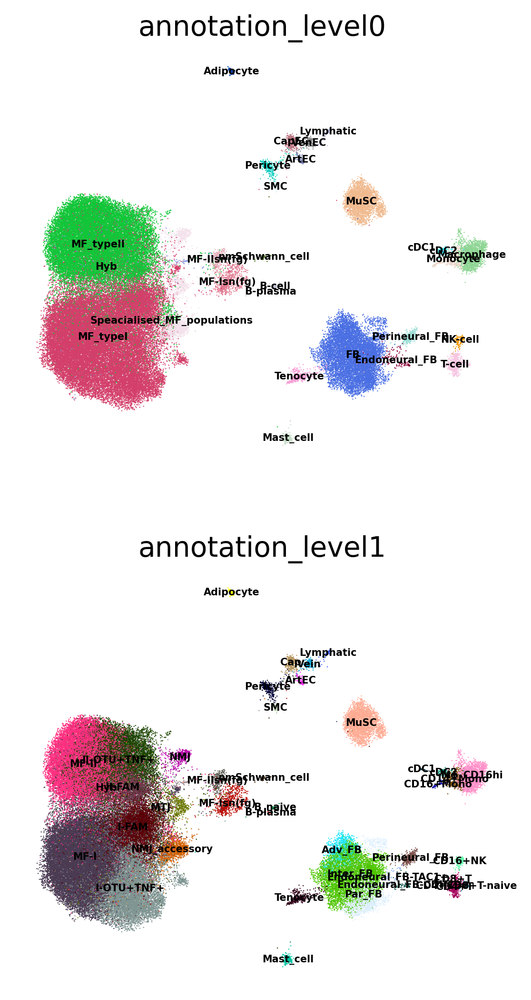

In [159]:
sc.pl.umap(adata_scvi_dbrm2, color = ['annotation_level0', 'annotation_level1'],legend_loc = "on data", legend_fontsize = 5, frameon = False, ncols = 1 )

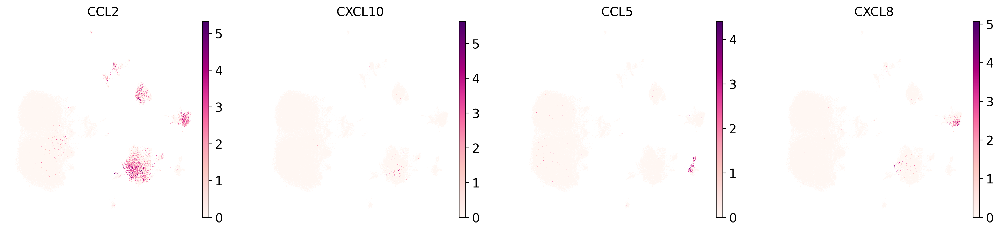

In [165]:
sc.pl.umap(adata_scvi_dbrm2, color = ['CCL2', 'CXCL10', 'CCL5', 'CXCL8'],legend_loc = "on data", legend_fontsize = 5, frameon = False, ncols = 5 )

In [160]:
adata_scvi_dbrm2.shape

(92259, 33538)

In [161]:
adata_scvi_dbrm2.write(f'{results}/ICM_snuclei_data_scvi1_dbrm2_final_{today}.h5ad')